In [1]:
pip install pandas-profiling

Looking in indexes: https://pypi.org/simple, https://pip.repos.neuron.amazonaws.com
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 324.4/324.4 kB 9.5 MB/s eta 0:00:0000:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 344.5/344.5 kB 9.4 MB/s eta 0:00:0000:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 679.5/679.5 kB 22.7 MB/s eta 0:00:0000:01
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 102.7/102.7 kB 26.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 84.8 MB/s eta 0:00:00:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.7/4.7 MB 54.0 MB/s eta 0:00:00:00:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 6.1 MB/s eta 0:00:00a 0:00:01
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27082 sha256=b89343c156ad9103507436806cf307463200c6bd972a22440d191e1f1436051c
  Stored in directory: /home/ec2-user/.cache/pip/wheels/ea/1c/a8/5cec3479cd45136a7111e2d96aac299b219b199c411665250b
Su

In [27]:
pip install catboost

Looking in indexes: https://pypi.org/simple, https://pip.repos.neuron.amazonaws.com
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 76.6/76.6 MB 10.7 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 47.0/47.0 kB 664.7 kB/s eta 0:00:00a 0:00:01
Note: you may need to restart the kernel to use updated packages.


In [2]:
%matplotlib inline

In [61]:
import boto3
import pandas as pd; pd.set_option('display.max_column', 100)
import numpy as np
import matplotlib.pyplot as plt
import pandas_profiling as pp
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

from sklearn.impute import KNNImputer

from sklearn.ensemble import RandomForestClassifier

from catboost import CatBoostClassifier

from sklearn.metrics import roc_auc_score

## define bucket in which you are trying to reach
s3 = boto3.resource('s3')
bucket_name = 'daltondencklau-data445-bucket'
bucket = s3.Bucket(bucket_name)

## define csv file to read in the bucket
file_key= 'train(1).csv'

## syntax to allow us to read the file
bucket_object = bucket.Object(file_key)
file_object = bucket_object.get()
file_content_stream = file_object.get('Body')

## reading the training data file
train_data = pd.read_csv(file_content_stream)
train_data.head()

,id,product_code,loading,attribute_0,attribute_1,attribute_2,attribute_3,measurement_0,measurement_1,measurement_2,measurement_3,measurement_4,measurement_5,measurement_6,measurement_7,measurement_8,measurement_9,measurement_10,measurement_11,measurement_12,measurement_13,measurement_14,measurement_15,measurement_16,measurement_17,failure
0,0,A,80.10,material_7,material_8,9,5,7,8,4,18.040,12.518,15.748,19.292,11.739,20.155,10.672,15.859,17.594,15.193,15.029,NaN,13.034,14.684,764.100,0
1,1,A,84.89,material_7,material_8,9,5,14,3,3,18.213,11.540,17.717,17.893,12.748,17.889,12.448,17.947,17.915,11.755,14.732,15.425,14.395,15.631,682.057,0
2,2,A,82.43,material_7,material_8,9,5,12,1,5,18.057,11.652,16.738,18.240,12.718,18.288,12.715,15.607,NaN,13.798,16.711,18.631,14.094,17.946,663.376,0
3,3,A,101.07,material_7,material_8,9,5,13,2,6,17.295,11.188,18.576,18.339,12.583,19.060,12.471,16.346,18.377,10.020,15.250,15.562,16.154,17.172,826.282,0
4,4,A,188.06,material_7,material_8,9,5,9,2,8,19.346,12.950,16.990,15.746,11.306,18.093,10.337,17.082,19.932,12.428,16.182,12.760,13.153,16.412,579.885,0


In [62]:
## reporting the number of observations for each product_code
train_data['product_code'].value_counts()

C    5765
E    5343
B    5250
D    5112
A    5100
Name: product_code, dtype: int64

(0.0, 10000.0)

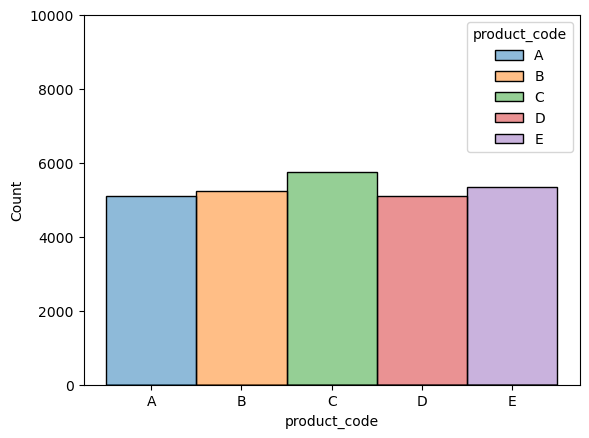

In [86]:
## visualizing product code distribution (https://seaborn.pydata.org/generated/seaborn.histplot.html)
sns.histplot(x = 'product_code',hue = 'product_code', data = train_data);
plt.ylim(0, 10000)

### EDA: Pandas Profiling
***

In [4]:
## creating visualization for target variable (https://towardsdatascience.com/exploratory-data-analysis-with-pandas-profiling-de3aae2ddff3)
profile = pp.ProfileReport(train_data, title="EDA", explorative=True)

## printing using HTML
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

From the above visualization library, I can see that the target variable is highly imbalacned, therefore, I will need to stratify the Y variable when I split the data.

From the heat map, it does not appear that a single variable has high correlation with the target variable, 'failiure'. I am unsure as to why, but maybe this has to do with how imbalanced the target variable is. There is slight correlation between failure and the variable 'loading' but it's not strong enough to consider. 

Many of the input variables have normal distribution, however, there are some features with right skewdness (specifically measurement_2).

### KNN Imputer
***

In [21]:
train_data.head()

,id,product_code,loading,attribute_0,attribute_1,attribute_2,attribute_3,measurement_0,measurement_1,measurement_2,measurement_3,measurement_4,measurement_5,measurement_6,measurement_7,measurement_8,measurement_9,measurement_10,measurement_11,measurement_12,measurement_13,measurement_14,measurement_15,measurement_16,measurement_17,failure
0,0,A,80.10,material_7,material_8,9,5,7,8,4,18.040,12.518,15.748,19.292,11.739,20.155,10.672,15.859,17.594,15.193,15.029,NaN,13.034,14.684,764.100,0
1,1,A,84.89,material_7,material_8,9,5,14,3,3,18.213,11.540,17.717,17.893,12.748,17.889,12.448,17.947,17.915,11.755,14.732,15.425,14.395,15.631,682.057,0
2,2,A,82.43,material_7,material_8,9,5,12,1,5,18.057,11.652,16.738,18.240,12.718,18.288,12.715,15.607,NaN,13.798,16.711,18.631,14.094,17.946,663.376,0
3,3,A,101.07,material_7,material_8,9,5,13,2,6,17.295,11.188,18.576,18.339,12.583,19.060,12.471,16.346,18.377,10.020,15.250,15.562,16.154,17.172,826.282,0
4,4,A,188.06,material_7,material_8,9,5,9,2,8,19.346,12.950,16.990,15.746,11.306,18.093,10.337,17.082,19.932,12.428,16.182,12.760,13.153,16.412,579.885,0


In [73]:
## defining inputs and target variable
x = train_data.drop(columns = ['failure'], axis =1)
y = train_data['failure']

## splitting the data
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.2, stratify = y)

In [74]:
## dropping non-numeric variables
x_train_i= x_train.drop(columns=['product_code', 'attribute_0', 'attribute_1'], axis=1)
x_test_i= x_test.drop(columns=['product_code', 'attribute_0', 'attribute_1'], axis=1)

In [75]:
x_train_i.describe()

,id,loading,attribute_2,attribute_3,measurement_0,measurement_1,measurement_2,measurement_3,measurement_4,measurement_5,measurement_6,measurement_7,measurement_8,measurement_9,measurement_10,measurement_11,measurement_12,measurement_13,measurement_14,measurement_15,measurement_16,measurement_17
count,21256.000000,21057.000000,21256.000000,21256.000000,21256.000000,21256.000000,21256.000000,20938.000000,20825.000000,20711.000000,20598.000000,20499.000000,20427.000000,20265.000000,20236.000000,20075.000000,19972.000000,19830.000000,19748.000000,19624.000000,19556.000000,19426.000000
mean,13295.977559,128.042196,6.752588,7.235228,7.411037,8.234710,6.263549,17.792567,11.730824,17.132304,17.514454,11.715049,19.024953,11.432548,16.124928,19.169380,11.705631,15.658204,16.045704,14.994276,16.455841,701.973234
std,7670.790980,39.096502,1.471566,1.457722,4.102840,4.205876,3.317182,1.002523,0.998038,1.000396,0.993701,1.000206,1.013281,0.997633,1.403449,1.517356,1.490087,1.157906,1.490415,1.551909,1.707259,123.370478
min,0.000000,40.810000,5.000000,5.000000,0.000000,0.000000,0.000000,13.968000,8.008000,12.813000,12.715000,7.968000,15.217000,7.537000,9.323000,12.620000,5.167000,11.289000,9.140000,9.104000,9.701000,196.787000
25%,6651.750000,100.210000,6.000000,6.000000,4.000000,5.000000,4.000000,17.119000,11.047000,16.446500,16.848000,11.044000,18.340000,10.757000,15.217000,18.168000,10.697000,14.890000,15.053750,13.954000,15.268000,619.401500
50%,13335.500000,122.480000,6.000000,8.000000,7.000000,8.000000,6.000000,17.789000,11.732000,17.134000,17.520000,11.709000,19.021000,11.433000,16.130500,19.211000,11.719500,15.633000,16.040000,14.969000,16.433000,702.239500
75%,19937.250000,149.490000,8.000000,8.000000,10.000000,11.000000,8.000000,18.475000,12.409000,17.815000,18.181000,12.386000,19.709000,12.108000,17.025000,20.200000,12.715000,16.386000,17.078000,16.019250,17.620000,784.754750
max,26568.000000,350.350000,9.000000,9.000000,27.000000,29.000000,24.000000,21.499000,16.484000,21.425000,21.543000,15.419000,23.807000,15.412000,22.479000,25.640000,17.663000,22.388000,22.303000,21.626000,23.164000,1312.794000


#### Imputation 1

In [76]:
## defining the imputer
imputer= KNNImputer(n_neighbors= 5, weights= 'distance').fit(x_train_i)

## imputing the missing values
x_train_imp= pd.DataFrame(imputer.transform(x_train_i), columns= x_train_i.columns)
x_test_imp= pd.DataFrame(imputer.transform(x_test_i), columns= x_test_i.columns)

In [77]:
x_train_imp.describe()

,id,loading,attribute_2,attribute_3,measurement_0,measurement_1,measurement_2,measurement_3,measurement_4,measurement_5,measurement_6,measurement_7,measurement_8,measurement_9,measurement_10,measurement_11,measurement_12,measurement_13,measurement_14,measurement_15,measurement_16,measurement_17
count,21256.000000,21256.000000,21256.000000,21256.000000,21256.000000,21256.000000,21256.000000,21256.000000,21256.000000,21256.000000,21256.000000,21256.000000,21256.000000,21256.000000,21256.000000,21256.000000,21256.000000,21256.000000,21256.000000,21256.000000,21256.000000,21256.000000
mean,13295.977559,128.025224,6.752588,7.235228,7.411037,8.234710,6.263549,17.793107,11.730864,17.132417,17.515374,11.715558,19.023797,11.433394,16.122412,19.168235,11.707173,15.657896,16.044341,14.990465,16.455526,702.061240
std,7670.790980,38.955319,1.471566,1.457722,4.102840,4.205876,3.317182,0.996821,0.990146,0.990972,0.981925,0.986457,0.997963,0.979575,1.377975,1.484245,1.456377,1.127395,1.449772,1.506536,1.653971,119.159842
min,0.000000,40.810000,5.000000,5.000000,0.000000,0.000000,0.000000,13.968000,8.008000,12.813000,12.715000,7.968000,15.217000,7.537000,9.323000,12.620000,5.167000,11.289000,9.140000,9.104000,9.701000,196.787000
25%,6651.750000,100.430000,6.000000,6.000000,4.000000,5.000000,4.000000,17.127310,11.060000,16.460000,16.865000,11.062000,18.362000,10.781000,15.244000,18.213750,10.743993,14.930914,15.106000,14.001000,15.334000,625.258250
50%,13335.500000,122.530000,6.000000,8.000000,7.000000,8.000000,6.000000,17.791000,11.733000,17.133000,17.520000,11.711000,19.019000,11.432000,16.126000,19.202820,11.719000,15.634000,16.038000,14.966899,16.438500,702.372957
75%,19937.250000,149.342500,8.000000,8.000000,10.000000,11.000000,8.000000,18.466000,12.399000,17.802000,18.166000,12.370000,19.690000,12.083000,16.995000,20.152000,12.673000,16.342000,17.016250,15.957000,17.542000,778.852500
max,26568.000000,350.350000,9.000000,9.000000,27.000000,29.000000,24.000000,21.499000,16.484000,21.425000,21.543000,15.419000,23.807000,15.412000,22.479000,25.640000,17.663000,22.388000,22.303000,21.626000,23.164000,1312.794000


#### Catboost Model 1

In [78]:
## building catboost model
cb_md1 = CatBoostClassifier(iterations = 150, 
                                  verbose = False, 
                                  learning_rate = 0.0001, 
                                  depth = 3).fit(x_train_imp, y_train)

## predicting on the testing dataset
cb_preds1 = cb_md1.predict_proba(x_test_imp)[:, 1]

## computing auc_roc score
cb_auc1 = roc_auc_score(y_test, cb_preds1)

## printing auc roc score
print('The AUC-ROC score for the first CatBoost Model is:', cb_auc1)

The AUC-ROC score for the first CatBoost Model is: 0.5780929034332223


#### Imputation 2

For these models, we will still use KNN imputer but now we will impute values based on product. For example, all missing values within product code a will be imputed using product code a values.

In [79]:
## imputating product code A
train_code_A = x_train[x_train['product_code'] == 'A']
y_train_code_A = y_train.loc[x_train['product_code'] == 'A']
test_code_A = x_test[x_test['product_code'] == 'A']
y_test_code_A = y_test.loc[x_test['product_code'] == 'A']

## dropping non-numeric variables
train_code_A = train_code_A.drop(columns = ['product_code', 'attribute_0', 'attribute_1'], axis=1)
test_code_A = test_code_A.drop(columns = ['product_code', 'attribute_0', 'attribute_1'], axis=1)

## defining the imputer
impyer = KNNImputer(n_neighbors = 5 , weights = 'distance').fit(train_code_A)
                              
## imputing missing values 
train_code_A = pd.DataFrame(imputer.transform(train_code_A), columns = train_code_A.columns).reset_index(drop = True)
test_code_A = pd.DataFrame(imputer.transform(test_code_A), columns = test_code_A.columns).reset_index(drop = True)



## imputating product code B
train_code_B = x_train[x_train['product_code'] == 'B']
y_train_code_B = y_train.loc[x_train['product_code'] == 'B']
test_code_B = x_test[x_test['product_code'] == 'B']
y_test_code_B = y_test.loc[x_test['product_code'] == 'B']

## dropping non-numeric variables
train_code_B = train_code_B.drop(columns = ['product_code', 'attribute_0', 'attribute_1'], axis=1)
test_code_B = test_code_B.drop(columns = ['product_code', 'attribute_0', 'attribute_1'], axis=1)

## defining the imputer
impyer = KNNImputer(n_neighbors = 5 , weights = 'distance').fit(train_code_B)
                              
## imputing missing values 
train_code_B = pd.DataFrame(imputer.transform(train_code_B), columns = train_code_B.columns).reset_index(drop = True)
test_code_B = pd.DataFrame(imputer.transform(test_code_B), columns = test_code_B.columns).reset_index(drop = True)



## imputating product code C
train_code_C = x_train[x_train['product_code'] == 'C']
y_train_code_C = y_train.loc[x_train['product_code'] == 'C']
test_code_C = x_test[x_test['product_code'] == 'C']
y_test_code_C = y_test.loc[x_test['product_code'] == 'C']

## dropping non-numeric variables
train_code_C = train_code_C.drop(columns = ['product_code', 'attribute_0', 'attribute_1'], axis=1)
test_code_C = test_code_C.drop(columns = ['product_code', 'attribute_0', 'attribute_1'], axis=1)

## defining the imputer
impyer = KNNImputer(n_neighbors = 5 , weights = 'distance').fit(train_code_C)
                              
## imputing missing values 
train_code_C = pd.DataFrame(imputer.transform(train_code_C), columns = train_code_C.columns).reset_index(drop = True)
test_code_C = pd.DataFrame(imputer.transform(test_code_C), columns = test_code_C.columns).reset_index(drop = True)



## imputating product code D
train_code_D = x_train[x_train['product_code'] == 'D']
y_train_code_D = y_train.loc[x_train['product_code'] == 'D']
test_code_D = x_test[x_test['product_code'] == 'D']
y_test_code_D = y_test.loc[x_test['product_code'] == 'D']

## dropping non-numeric variables
train_code_D = train_code_D.drop(columns = ['product_code', 'attribute_0', 'attribute_1'], axis=1)
test_code_D = test_code_D.drop(columns = ['product_code', 'attribute_0', 'attribute_1'], axis=1)

## defining the imputer
impyer = KNNImputer(n_neighbors = 5 , weights = 'distance').fit(train_code_D)
                              
## imputing missing values 
train_code_D = pd.DataFrame(imputer.transform(train_code_D), columns = train_code_D.columns).reset_index(drop = True)
test_code_D = pd.DataFrame(imputer.transform(test_code_D), columns = test_code_D.columns).reset_index(drop = True)



## imputating product code E
train_code_E = x_train[x_train['product_code'] == 'E']
y_train_code_E = y_train.loc[x_train['product_code'] == 'E']
test_code_E = x_test[x_test['product_code'] == 'E']
y_test_code_E = y_test.loc[x_test['product_code'] == 'E']

## dropping non-numeric variables
train_code_E = train_code_E.drop(columns = ['product_code', 'attribute_0', 'attribute_1'], axis=1)
test_code_E = test_code_E.drop(columns = ['product_code', 'attribute_0', 'attribute_1'], axis=1)

## defining the imputer
impyer = KNNImputer(n_neighbors = 5 , weights = 'distance').fit(train_code_E)
                              
## imputing missing values 
train_code_E = pd.DataFrame(imputer.transform(train_code_E), columns = train_code_E.columns).reset_index(drop = True)
test_code_E = pd.DataFrame(imputer.transform(test_code_E), columns = test_code_E.columns).reset_index(drop = True)

In [80]:
## Combining all of the train and test codes for product A-E
train_code= pd.concat([train_code_A, train_code_B, train_code_C, train_code_D, train_code_E], axis=0)
train_y_code = pd.concat([y_train_code_A, y_train_code_B, y_train_code_C, y_train_code_D, y_train_code_E], axis = 0) 

test_code= pd.concat([test_code_A, test_code_B, test_code_C, test_code_D, test_code_E], axis=0)
test_y_code = pd.concat([y_test_code_A, y_test_code_B, y_test_code_C, y_test_code_D, y_test_code_E], axis = 0) 

#### Catboost Model 2

In [87]:
## building catboost model
cb_md2 = CatBoostClassifier(iterations = 150, 
                                  verbose = False, 
                                  learning_rate = 0.0001, 
                                  depth = 3).fit(train_code, train_y_code)

## predicting on the testing dataset
cb_preds2 = cb_md1.predict_proba(x_test_imp)[:, 1]

## computing auc_roc score
cb_auc2 = roc_auc_score(test_y_code, cb_preds2)

## printing auc roc score
print('The AUC-ROC score for the second CatBoost Model is:', cb_auc2)

The AUC-ROC score for the second CatBoost Model is: 0.4827251730147719


Based on the AUC ROC scores from these models, I would choose the first model to predict failure. Model 1 had a higher AUC ROC of 0.578 compared to model 2, which had a score of 0.483. However, further hyperparamter tuning is necessary because neither model's performance was impressive. 